<a href="https://colab.research.google.com/github//pylabel-project/samples/blob/main/voc2coco.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a> 

# Convert VOC XML Annotations to COCO JSON
Use this notebook to try out importing, analyzing, and exporting datasets of image annotations. 

In [1]:
import logging
logging.getLogger().setLevel(logging.CRITICAL)
!pip install pylabel > /dev/null


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: pip install --upgrade pip


In [2]:
from pylabel import importer

## Import VOC annotations 
First we will import annotations from the BCCD dataset, a small public dataset with images of blood cells (https://github.com/Shenggan/BCCD_Dataset).

In [6]:
# Setup annotations and images 
path_to_annotations = "../datasets/LADDv5/train_ds/"

#Identify the path to get from the annotations to the images 
path_to_images = "../JPEGImages/"

dataset = importer.ImportVOC(path=path_to_annotations, path_to_images=path_to_images)
dataset.df.head(5)

Importing VOC files...: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 268/268 [00:00<00:00, 3218.20it/s]


,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_iscrowd,ann_keypoints,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,../JPEGImages/,890,NaN,0,4864,3648,3,0,1768.0,630.0,...,NaN,NaN,Unspecified,0,0,0,Pedestrian,NaN,,1
1,../JPEGImages/,992,NaN,1,4864,3648,3,0,3171.0,996.0,...,NaN,NaN,Unspecified,0,0,0,Pedestrian,NaN,,1
2,../JPEGImages/,910,NaN,2,4864,3648,3,0,1426.0,1975.0,...,NaN,NaN,Unspecified,0,0,0,Pedestrian,NaN,,1
3,../JPEGImages/,911,NaN,3,4864,3648,3,0,3043.0,2323.0,...,NaN,NaN,Unspecified,0,0,0,Pedestrian,NaN,,1
4,../JPEGImages/,885,NaN,4,5472,3078,3,0,3278.0,2533.0,...,NaN,NaN,Unspecified,0,0,0,Pedestrian,NaN,,1


In [13]:
dataset.df['img_filename'] = dataset.df['img_filename'] + '.jpg'

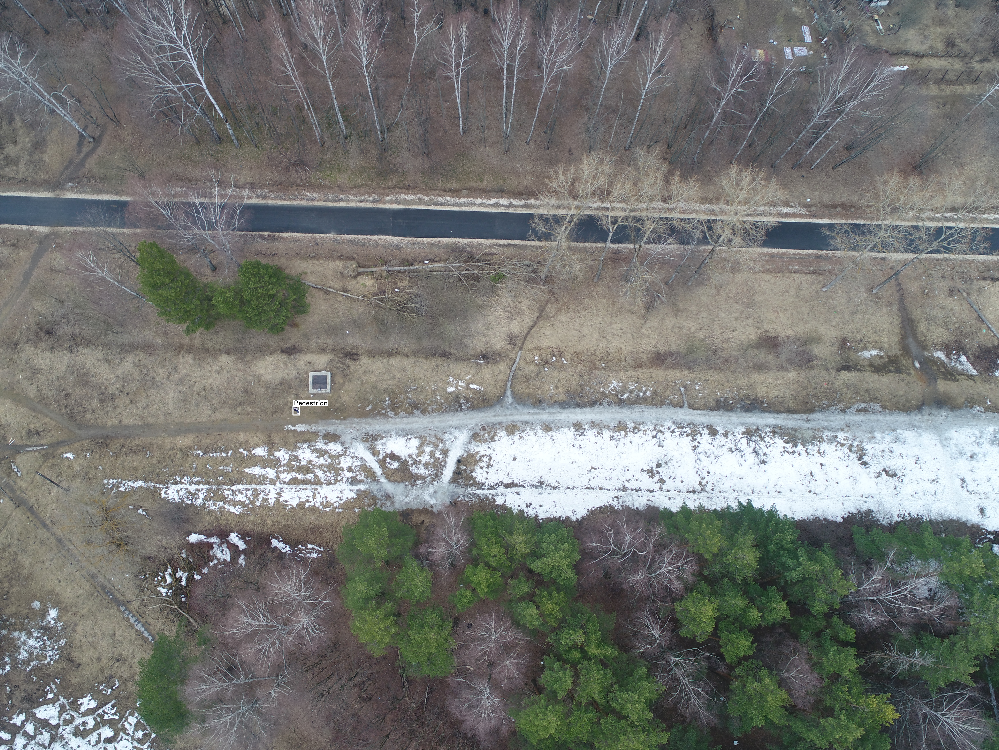

In [16]:
#Confirm that there are images by displaying an image
from IPython.display import display
display(dataset.visualize.ShowBoundingBoxes(2))

## Analyze annotations
Pylabel can calculate basic summary statisticts about the dataset such as the number of files and the classes. 
The dataset is stored as a pandas frame so the developer can do additional exploratory analysis on the dataset. 

In [6]:
print(f"Number of images: {dataset.analyze.num_images}")
print(f"Number of classes: {dataset.analyze.num_classes}")
print(f"Classes:{dataset.analyze.classes}")
print(f"Class counts:\n{dataset.analyze.class_counts}")

Number of images: 1495
Number of classes: 1
Classes:['Pedestrian']
Class counts:
cat_name
Pedestrian    5134
Name: count, dtype: int64


# Export to Yolo
The PyLabel exporter will export all of the annotations in the dataframe to the desired target format.
All annotations will be stored in a single json file. 

In [8]:
dataset.export.ExportToYoloV5()

Exporting YOLO files...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1495/1495 [00:02<00:00, 666.41it/s]


['training/dataset.yaml',
 'training/labels/1358.txt',
 'training/labels/171.txt',
 'training/labels/744.txt',
 'training/labels/1120.txt',
 'training/labels/426.txt',
 'training/labels/890.txt',
 'training/labels/992.txt',
 'training/labels/42.txt',
 'training/labels/455.txt',
 'training/labels/538.txt',
 'training/labels/1275.txt',
 'training/labels/500.txt',
 'training/labels/1122.txt',
 'training/labels/228.txt',
 'training/labels/1298.txt',
 'training/labels/720.txt',
 'training/labels/59.txt',
 'training/labels/910.txt',
 'training/labels/911.txt',
 'training/labels/1260.txt',
 'training/labels/458.txt',
 'training/labels/1355.txt',
 'training/labels/1368.txt',
 'training/labels/524.txt',
 'training/labels/1233.txt',
 'training/labels/460.txt',
 'training/labels/539.txt',
 'training/labels/325.txt',
 'training/labels/436.txt',
 'training/labels/885.txt',
 'training/labels/1180.txt',
 'training/labels/403.txt',
 'training/labels/369.txt',
 'training/labels/233.txt',
 'training/lab

In [17]:
df = dataset.df

In [20]:
len(df)

885